In [1]:
# alexnet_deconvnet_all_layers.py
import argparse
from typing import List, Tuple, Dict

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, transforms
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
IMG_SIZE = 224
IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406], device=DEVICE).view(1,3,1,1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225], device=DEVICE).view(1,3,1,1)

# ---------- Model & I/O ----------
def load_alexnet() -> nn.Module:
    try:
        model = models.alexnet(weights=models.AlexNet_Weights.IMAGENET1K_V1)
    except Exception:
        model = models.alexnet(pretrained=True)
    return model.eval().to(DEVICE)

def load_image(path: str) -> Tuple[Image.Image, torch.Tensor]:
    tfm = transforms.Compose([
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(mean=IMAGENET_MEAN.flatten().tolist(),
                             std=IMAGENET_STD.flatten().tolist())
    ])
    pil = Image.open(path).convert("RGB")
    x = tfm(pil).unsqueeze(0).to(DEVICE)
    return pil, x

def denorm_rgb(t: torch.Tensor) -> np.ndarray:
    """t: [1,3,H,W] (normalized) -> uint8 HxWx3"""
    t = t * IMAGENET_STD + IMAGENET_MEAN
    t = t.clamp(0,1)[0].permute(1,2,0).detach().cpu().numpy()
    return (t * 255.0).astype(np.uint8)

# ---------- Forward with switches ----------
class ForwardRecorder:
    """
    Manually executes model.features and records:
      - conv outputs, relu outputs
      - maxpool indices (switches) + pre-pool sizes for MaxUnpool
    """
    def __init__(self, model: nn.Module):
        self.model = model
        self.seq: List[nn.Module] = list(model.features.children())
        self.names: List[str] = list(model.features._modules.keys())
        self.steps: List[Dict] = []

    def run(self, x: torch.Tensor) -> torch.Tensor:
        self.steps = []
        for name, layer in zip(self.names, self.seq):
            if isinstance(layer, nn.Conv2d):
                x = layer(x)
                self.steps.append({"type":"conv", "name":f"features.{name}", "layer":layer, "out":x})
            elif isinstance(layer, nn.ReLU):
                x = F.relu(x, inplace=False)
                self.steps.append({"type":"relu", "name":f"features.{name}", "out":x})
            elif isinstance(layer, nn.MaxPool2d):
                in_size = x.shape
                x, idx = F.max_pool2d(
                    x,
                    kernel_size=layer.kernel_size,
                    stride=layer.stride,
                    padding=layer.padding,
                    dilation=getattr(layer, "dilation", 1),
                    ceil_mode=layer.ceil_mode,
                    return_indices=True # Returns the indicies that led to max pooling.
                )
                self.steps.append({
                    "type":"pool", "name":f"features.{name}",
                    "layer":layer, "out":x,
                    "indices":idx, # these are the switches used in max unpooling.
                    "out_size_before_pool":in_size # original shape of input to pooling. Used in unpooling later
                })
            else:
                x = layer(x)
                self.steps.append({"type":"other", "name":f"features.{name}", "layer":layer, "out":x})
        return x

    def list_conv_layers(self) -> List[str]:
        return [s["name"] for s in self.steps if s["type"]=="conv"]

    def relu_after(self, conv_name: str) -> int:
        for i, s in enumerate(self.steps):
            if s["type"]=="conv" and s["name"]==conv_name:
                j = i+1
                if j < len(self.steps) and self.steps[j]["type"]=="relu":
                    return j
                raise RuntimeError(f"No ReLU found immediately after {conv_name}")
        raise ValueError(f"Conv layer {conv_name} not found")

# ---------- Deconv Projector ----------
class DeconvProjector:
    """
    Zeiler & Fergus-style back-projection:
      Start from selected post-ReLU activation maps (zero others),
      then go backwards: ReLU -> MaxUnpool(using switches) -> ConvTranspose(with original weights)
    """
    def __init__(self, recorder: ForwardRecorder):
        self.R = recorder

    @staticmethod
    def conv_transpose(x: torch.Tensor, conv: nn.Conv2d) -> torch.Tensor:
        # Use original conv.weight directly (no permute)
        return F.conv_transpose2d(
            x, conv.weight, bias=None,
            stride=conv.stride, padding=conv.padding,
            dilation=conv.dilation, groups=conv.groups
        )

    @staticmethod
    def unpool(x: torch.Tensor, switches: torch.Tensor, pool: nn.MaxPool2d, out_size: Tuple[int]):
        return F.max_unpool2d(
            x, switches,
            kernel_size=pool.kernel_size,
            stride=pool.stride,
            padding=pool.padding,
            output_size=out_size
        )

    def project_single_channel(self, conv_name: str, c: int) -> Tuple[np.ndarray, np.ndarray]:
        """
        Returns (reconstruction_rgb_uint8, heatmap_0to1) for one channel c of layer conv_name.
        Heatmap is computed from |X| sum across channels pre-denorm, normalized to [0,1].
        """
        relu_idx = self.R.relu_after(conv_name)
        A = self.R.steps[relu_idx]["out"].detach().clone()  # [1,C,H,W]
        C = A.shape[1]
        if not (0 <= c < C):
            raise IndexError(f"Channel {c} out of range for {conv_name} with C={C}")

        # seed with just that channel's map
        X = torch.zeros_like(A)
        X[0, c] = A[0, c]

        # walk layers backward to pixel space
        for i in range(relu_idx, -1, -1):
            s = self.R.steps[i]
            if s["type"] == "relu":
                X = F.relu(X, inplace=False)
            elif s["type"] == "pool":
                X = self.unpool(X, s["indices"], s["layer"], s["out_size_before_pool"])
            elif s["type"] == "conv":
                X = self.conv_transpose(X, s["layer"])

        # heatmap from magnitude before de-normalizing (H,W) in [0,1]
        heat = X.abs().sum(dim=1, keepdim=True)  # [1,1,H,W]
        heat = heat - heat.min()
        heat = heat / (heat.max() + 1e-6)
        heat_np = heat[0,0].detach().cpu().numpy()

        # pretty RGB projection for reference
        rgb = denorm_rgb(X)
        return rgb, heat_np

# ---------- Viz helpers ----------
def overlay_heatmap_on_pil(pil_img: Image.Image, heat: np.ndarray, alpha: float = 0.45) -> None:
    """
    Show original + heatmap overlay in current axes.
    """
    # Resize heat to PIL size if needed
    H, W = pil_img.size[1], pil_img.size[0]
    if heat.shape != (H, W):
        heat = np.array(Image.fromarray((heat*255).astype(np.uint8)).resize(pil_img.size, Image.BILINEAR)) / 255.0
    plt.imshow(pil_img)
    plt.imshow(heat, cmap="jet", alpha=alpha)
    plt.axis("off")

def show_grid_with_titles(images: List[np.ndarray], titles: List[str], cols: int = 4, suptitle: str = ""):
    rows = int(np.ceil(len(images) / cols))
    plt.figure(figsize=(3.2*cols, 3.2*rows))
    for i, im in enumerate(images):
        plt.subplot(rows, cols, i+1)
        plt.imshow(im)
        plt.title(titles[i], fontsize=10)
        plt.axis("off")
    if suptitle:
        plt.suptitle(suptitle, fontsize=12)
    plt.tight_layout()
    plt.show()

def show_overlay_grid(pil_img: Image.Image, heats: List[np.ndarray], titles: List[str], cols: int = 4, suptitle: str = ""):
    rows = int(np.ceil(len(heats) / cols))
    plt.figure(figsize=(3.2*cols, 3.2*rows))
    for i, heat in enumerate(heats):
        plt.subplot(rows, cols, i+1)
        overlay_heatmap_on_pil(pil_img, heat, alpha=0.45)
        plt.title(titles[i], fontsize=10)
    if suptitle:
        plt.suptitle(suptitle, fontsize=12)
    plt.tight_layout()
    plt.show()

# ---------- Main: all layers, top-K with labels & overlays ----------
def run(image_path: str, topk: int = 16, show_raw: bool = False):
    model = load_alexnet()
    pil, x = load_image(image_path)

    rec = ForwardRecorder(model)
    _ = rec.run(x)
    conv_layers = rec.list_conv_layers()  # e.g., ['features.0','features.3','features.6','features.8','features.10']
    print("Conv layers:", conv_layers)

    proj = DeconvProjector(rec)

    for layer in conv_layers:
        # pick top-K channels by mean activation at this layer (post-ReLU)
        relu_idx = rec.relu_after(layer)
        A = rec.steps[relu_idx]["out"]  # [1,C,H,W]
        C = A.shape[1]
        means = A.mean(dim=(0,2,3))
        k = min(topk, C)
        top_channels = torch.topk(means, k=k).indices.tolist()

        # project each selected channel
        rgbs: List[np.ndarray] = []
        heats: List[np.ndarray] = []
        titles: List[str] = []
        for c in top_channels:
            rgb, heat = proj.project_single_channel(layer, c)
            rgbs.append(rgb)
            heats.append(heat)
            titles.append(f"ch {c}")

        # 1) Overlays (what part of the original image is focused): REQUIRED
        show_overlay_grid(pil, heats, titles, cols=4, suptitle=f"{layer} — overlays of top-{k} channels")

        # 2) (Optional) Raw reconstructions per filter
        if show_raw:
            show_grid_with_titles(rgbs, titles, cols=4, suptitle=f"{layer} — deconv reconstructions (top-{k})")

# # ---------- CLI ----------
# if __name__ == "__main__":
#     parser = argparse.ArgumentParser(description="AlexNet deconvnet projections for ALL conv layers with overlays + labels")
#     parser.add_argument("image", type=str, help="Path to input image")
#     parser.add_argument("--topk", type=int, default=16, help="Top-K filters per layer (by mean activation)")
#     parser.add_argument("--show-raw", action="store_true", help="Also show raw deconv reconstructions (in addition to overlays)")
#     args = parser.parse_args()
#     run(args.image, topk=args.topk, show_raw=args.show_raw)


Conv layers: ['features.0', 'features.3', 'features.6', 'features.8', 'features.10']


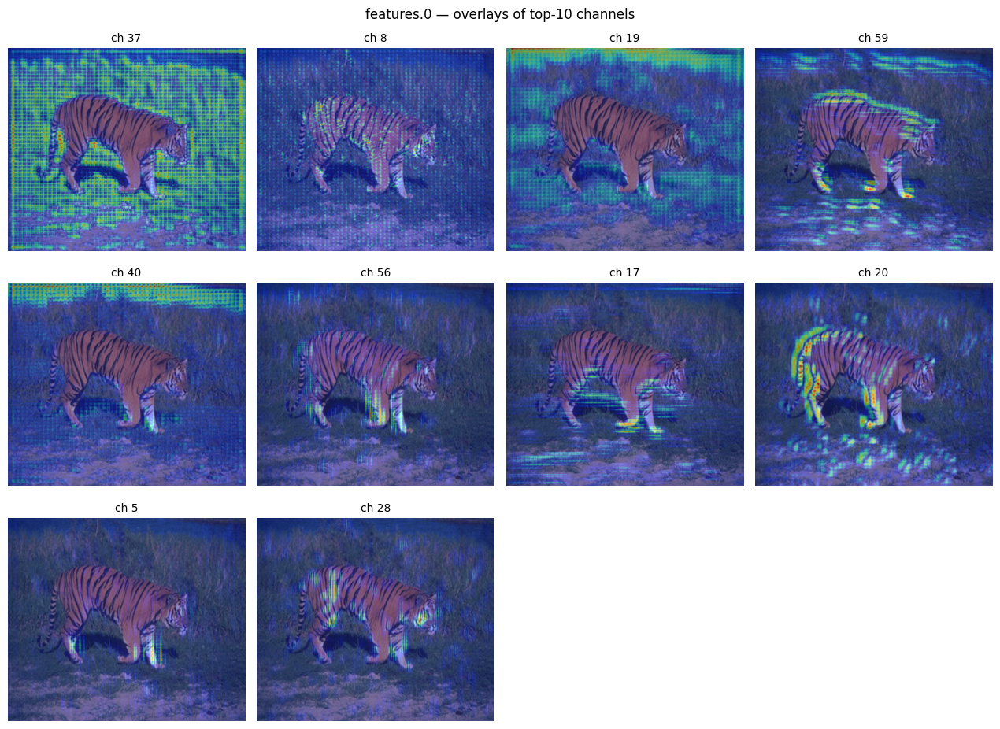

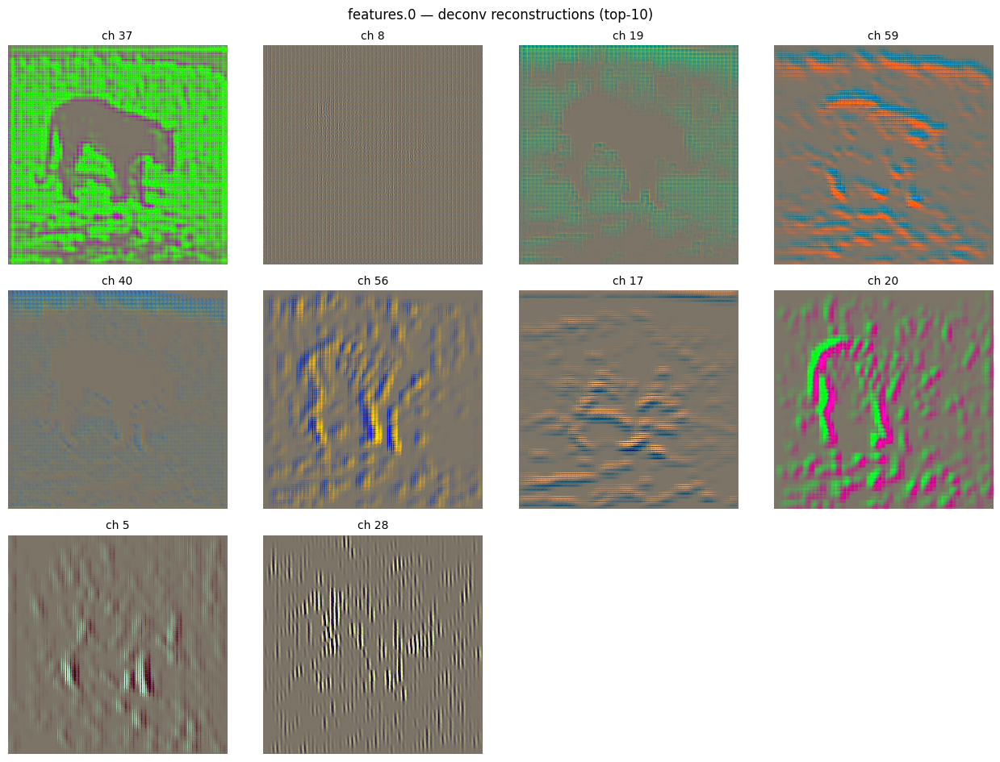

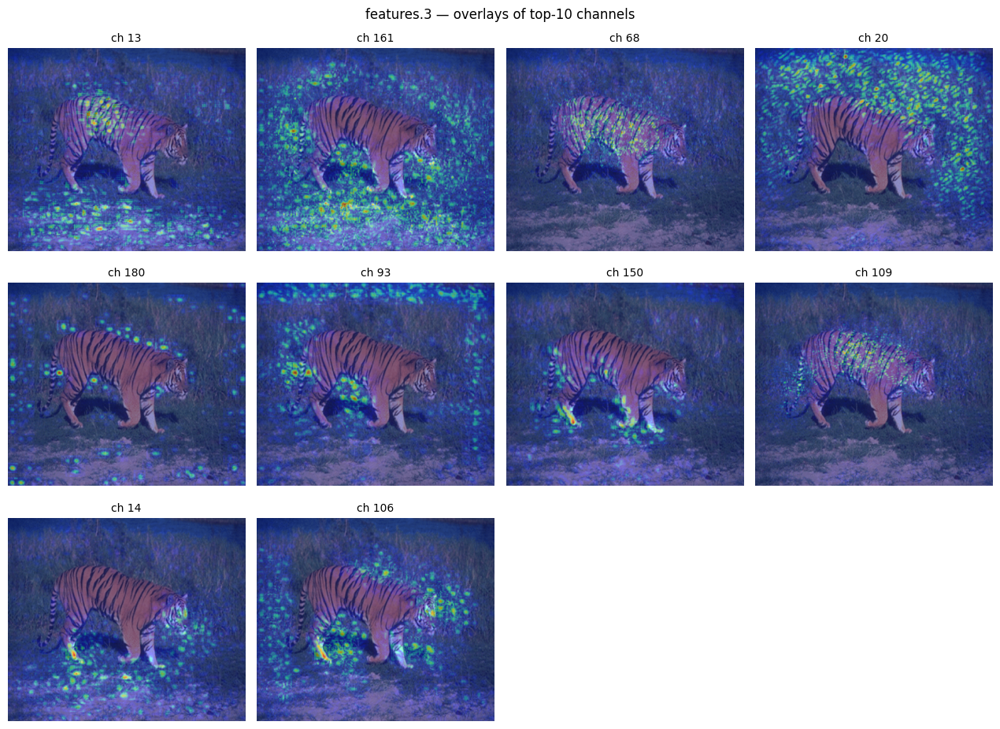

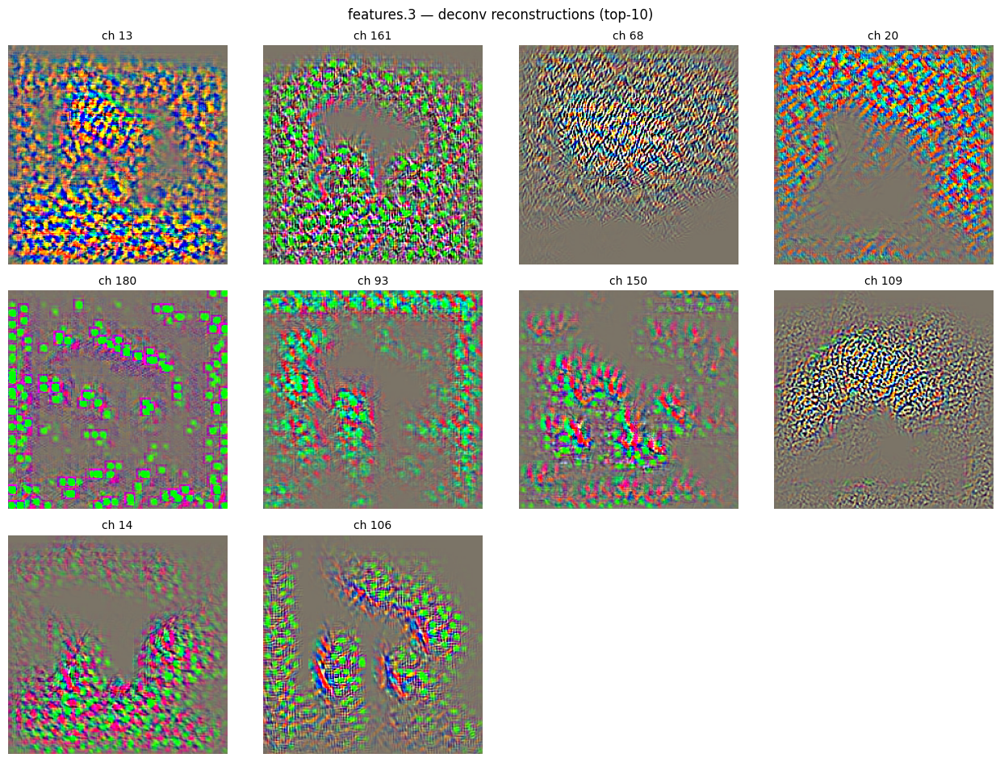

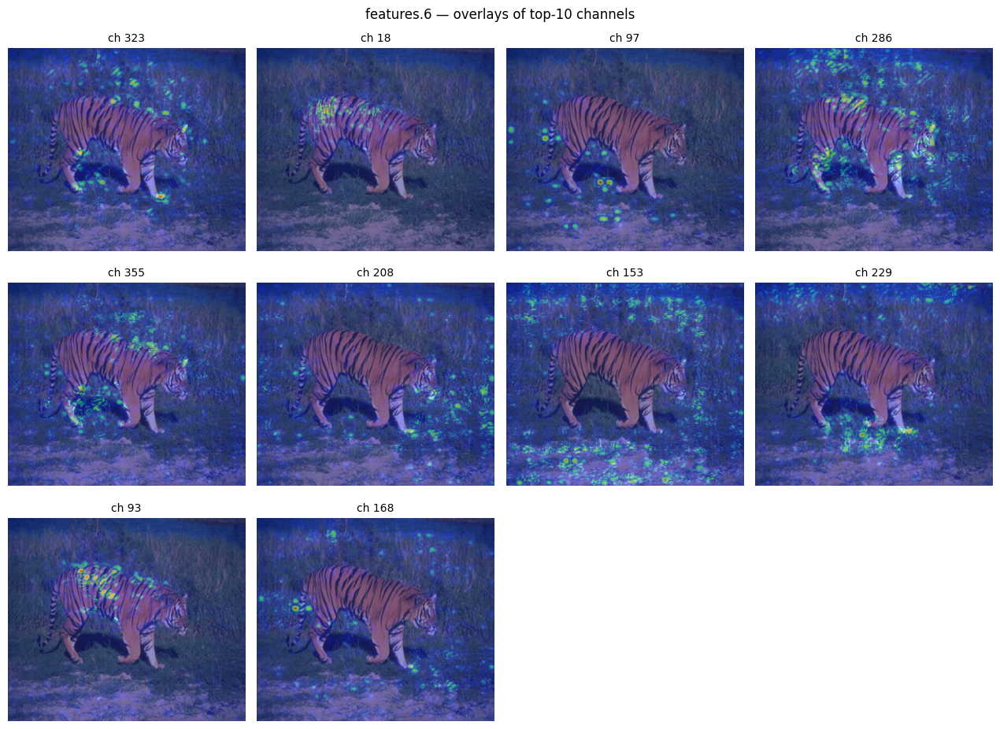

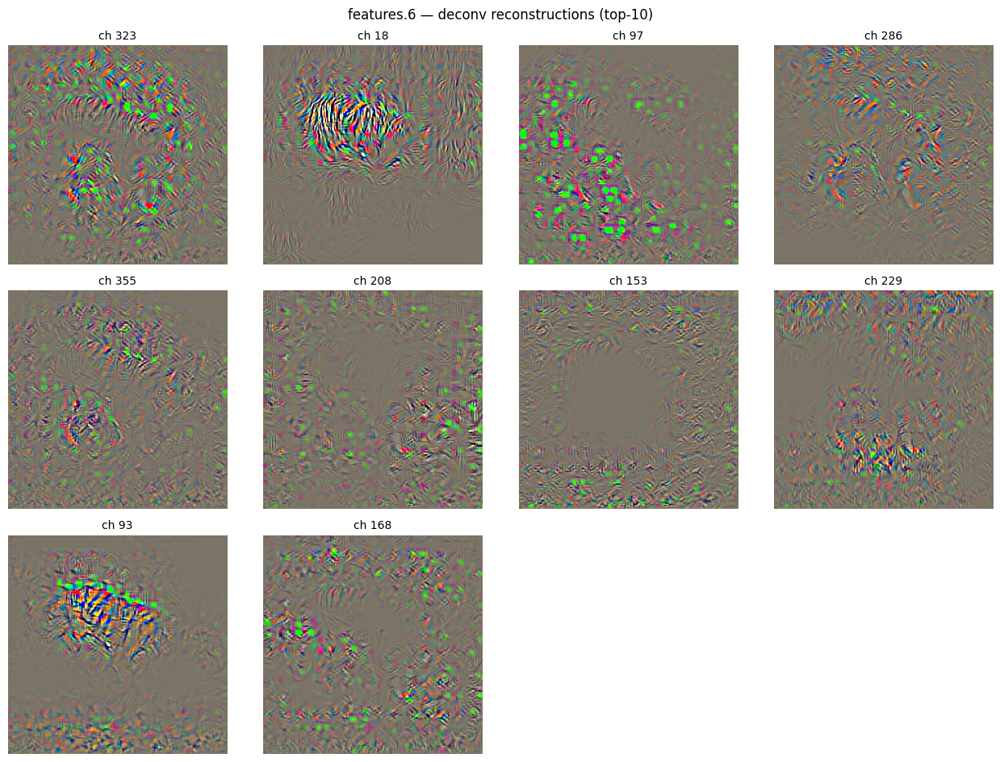

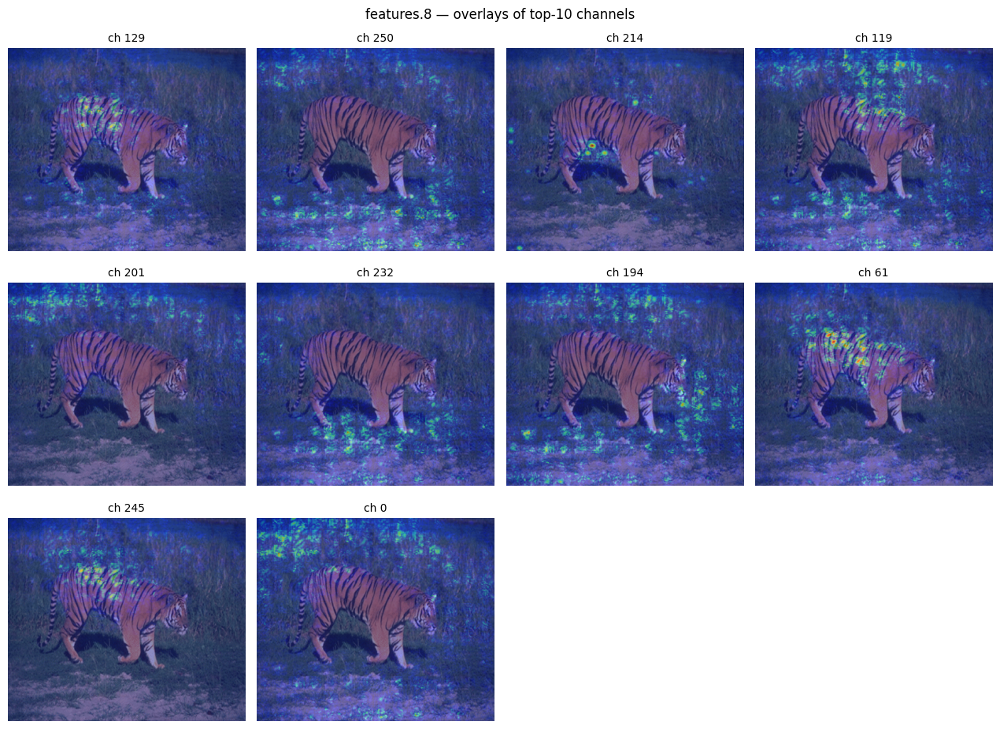

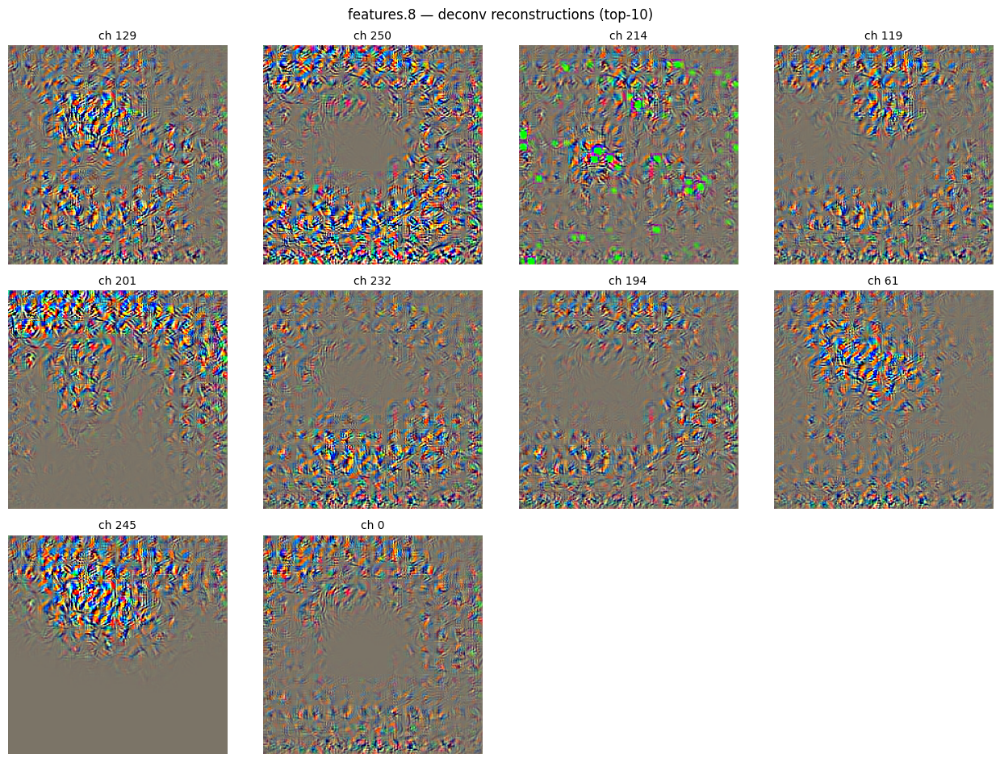

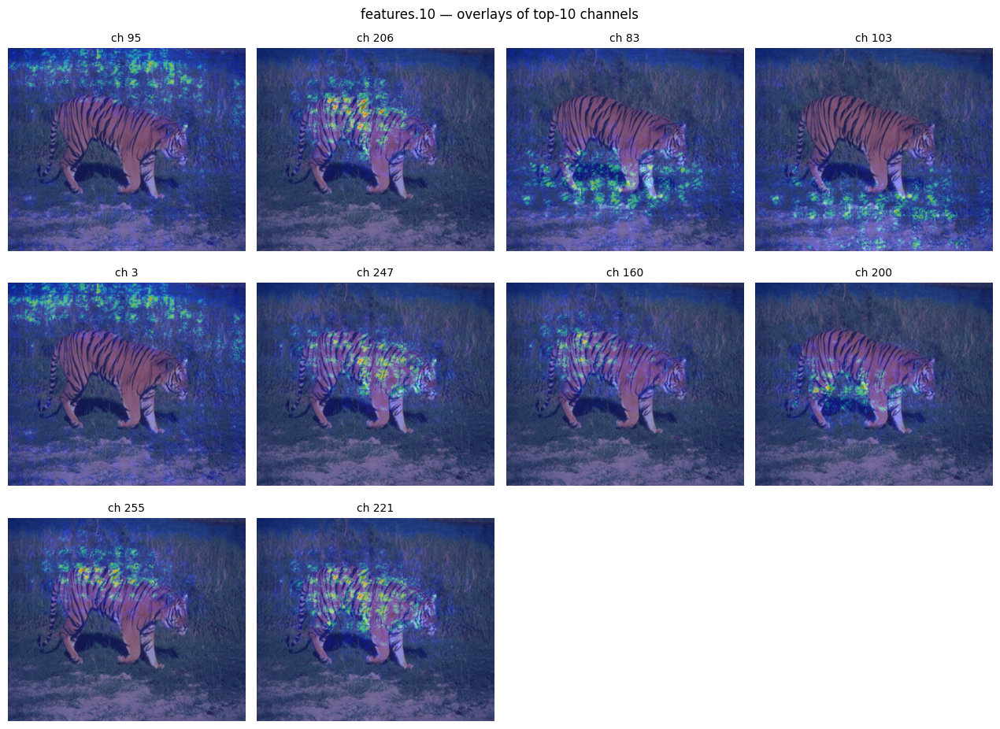

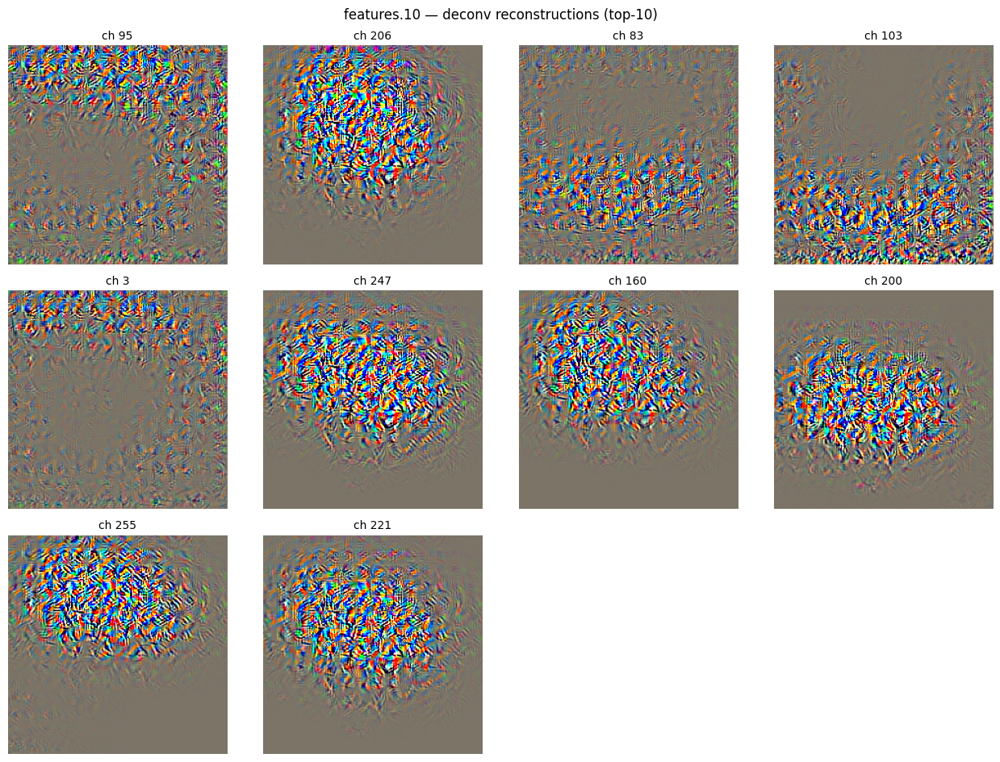

In [3]:
run('tiger.png', topk=10, show_raw=True)